<a href="https://colab.research.google.com/github/anushkaxp/Gold-price-prediction/blob/main/Gold_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import os
import shutil
import datetime
import gc
from tqdm import tqdm
import plotly.express as px

import pandas as pd
import numpy as np
from numpy import median

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='whitegrid')

from sklearn.manifold import TSNE
from sklearn import preprocessing

from collections import Counter

import string
import re
from nltk.corpus import stopwords

import scipy
from scipy import hstack


from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score


from sklearn.metrics import mean_squared_error as mse
from math import sqrt
from sklearn.linear_model import Ridge

from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression

from sklearn.model_selection import RandomizedSearchCV 
from scipy.stats import randint as sp_randint
from scipy.stats import uniform


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving 1_trading-statistics-jan-2018.xlsx to 1_trading-statistics-jan-2018.xlsx
Saving 2_trading-statistics-feb-2018.xlsx to 2_trading-statistics-feb-2018.xlsx
Saving 3_trading-statistics-mar-2018.xlsx to 3_trading-statistics-mar-2018.xlsx
Saving 4_trading-statistics-apr-2018.xlsx to 4_trading-statistics-apr-2018.xlsx
Saving 5_trading-statistics-may-2018.xlsx to 5_trading-statistics-may-2018.xlsx
Saving 6_trading-statistics-june-2018 (1).xlsx to 6_trading-statistics-june-2018 (1).xlsx
Saving 7_trading-statistics-jul-2018.xlsx to 7_trading-statistics-jul-2018.xlsx
Saving 8_trading-statistics-aug-2018.xlsx to 8_trading-statistics-aug-2018.xlsx
Saving 9_trading-statistics-sep-2018.xlsx to 9_trading-statistics-sep-2018.xlsx
Saving 10_trading-statistics-oct-2018.xlsx to 10_trading-statistics-oct-2018.xlsx
Saving 11_trading-statistics-nov-2018.xlsx to 11_trading-statistics-nov-2018.xlsx
Saving 12_trading-statistics-dec-2018.xlsx to 12_trading-statistics-dec-2018.xlsx
Saving 13_trading-statis

In [ ]:
path = os.getcwd()
files = os.listdir(path)
files

['.config',
 '41_trading-statistics-may-2019.xlsx',
 '38_trading-statistics-feb-2021.xlsx',
 '54_trading-statistics-june-2022.xlsx',
 '25_trading-statistics-jan-2020.xlsx',
 '12_trading-statistics-dec-2018.xlsx',
 '49_trading-statistics-jan-2022.xlsx',
 '37_trading-statistics-jan-2021.xlsx',
 '53_trading-statistics-may-2022.xlsx',
 '42_trading-statistics-jun-2021.xlsx',
 '47_trading-statistics-nov-2021.xlsx',
 '59_trading-statistics-november-2022.xlsx',
 '7_trading-statistics-jul-2018.xlsx',
 '17_trading-statistics-may-2018.xlsx',
 '60_trading-statistics-dec-2022.xlsx',
 '24_trading-statistics-dec-2019.xlsx',
 '1_trading-statistics-jan-2018.xlsx',
 '56_trading-statistics-aug-2022.xlsx',
 '57_trading-statistics-sep-2022.xlsx',
 '43_trading-statistics-jul-2021.xlsx',
 '15_trading-statistics-mar-2019.xlsx',
 '44_trading-statistics-aug-2021.xlsx',
 '8_trading-statistics-aug-2018.xlsx',
 '3_trading-statistics-mar-2018.xlsx',
 '39_trading-statistics-mar-2021.xlsx',
 '20_trading-statistics-au

In [ ]:
files_xlsx = [f for f in files if f[-4:] == "xlsx"]
files_xlsx

['41_trading-statistics-may-2019.xlsx',
 '38_trading-statistics-feb-2021.xlsx',
 '54_trading-statistics-june-2022.xlsx',
 '25_trading-statistics-jan-2020.xlsx',
 '12_trading-statistics-dec-2018.xlsx',
 '49_trading-statistics-jan-2022.xlsx',
 '37_trading-statistics-jan-2021.xlsx',
 '53_trading-statistics-may-2022.xlsx',
 '42_trading-statistics-jun-2021.xlsx',
 '47_trading-statistics-nov-2021.xlsx',
 '59_trading-statistics-november-2022.xlsx',
 '7_trading-statistics-jul-2018.xlsx',
 '17_trading-statistics-may-2018.xlsx',
 '60_trading-statistics-dec-2022.xlsx',
 '24_trading-statistics-dec-2019.xlsx',
 '1_trading-statistics-jan-2018.xlsx',
 '56_trading-statistics-aug-2022.xlsx',
 '57_trading-statistics-sep-2022.xlsx',
 '43_trading-statistics-jul-2021.xlsx',
 '15_trading-statistics-mar-2019.xlsx',
 '44_trading-statistics-aug-2021.xlsx',
 '8_trading-statistics-aug-2018.xlsx',
 '3_trading-statistics-mar-2018.xlsx',
 '39_trading-statistics-mar-2021.xlsx',
 '20_trading-statistics-aug-2019.xlsx'

In [ ]:
df = pd.DataFrame()
for f in files_xlsx:
    data = pd.read_excel(f)
    df = df.append(data)

In [ ]:
df

,Year,Month,Date,Derivative segment,Instrument Type,Name of the commodity,Symbol,Expiry Date,Price unit,Option Type,...,Spot Price for basis variety (in Rs)*,Premium Turnover (in Rs),Notional Turnover (Options)/ Turnover (Futures) (in Rs),Trading Volume (In Lots),Open Interest \n(In Lots),Lot size and unit,Open Interest (Options Notional Basis) / Open Interest (Futures) (in Rs),No.of trades,Mode of Trading (% of Turnover),Unnamed: 25
0,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaT,Equity Derivatives/ Currency Derivatives/ Inte...,Equity Index Future/ Stock Future/ Equity Inde...,NaN,NaN,NaT,NaN,Call Option/ Put Option,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ALGO,Non-ALGO
2,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31,1 KGS,N.A.,...,124,-,1765282450,14063,17578,1 MT,2228011500.0,8509,39.061255,60.938745
4,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28,1 KGS,N.A.,...,124,-,44077950,303,328,1 MT,47986400.0,292,49.679432,50.320568
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4596,Contracts with no volume and no Open Interest ...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4597,Spot price is not provided in case of Option C...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4598,In case of international referenceable commodi...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df = df.drop([0,1,2], axis = 0)

In [ ]:
df

,Year,Month,Date,Derivative segment,Instrument Type,Name of the commodity,Symbol,Expiry Date,Price unit,Option Type,...,Spot Price for basis variety (in Rs)*,Premium Turnover (in Rs),Notional Turnover (Options)/ Turnover (Futures) (in Rs),Trading Volume (In Lots),Open Interest \n(In Lots),Lot size and unit,Open Interest (Options Notional Basis) / Open Interest (Futures) (in Rs),No.of trades,Mode of Trading (% of Turnover),Unnamed: 25
3,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31,1 KGS,N.A.,...,124,-,1765282450,14063,17578,1 MT,2228011500.0,8509,39.061255,60.938745
4,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28,1 KGS,N.A.,...,124,-,44077950,303,328,1 MT,47986400.0,292,49.679432,50.320568
5,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-05-31,1 KGS,N.A.,...,-,-,1664891000,2277,1342,5 MT,987712000.0,1728,31.599606,68.400394
6,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-06-28,1 KGS,N.A.,...,-,-,35800750,49,136,5 MT,99926000.0,49,46.980161,53.019839
7,2019,May,2019-05-01,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-05-15,1 KGS,N.A.,...,-,-,-,-,129,100 KGS,25323990.0,-,-,-
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4596,Contracts with no volume and no Open Interest ...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4597,Spot price is not provided in case of Option C...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4598,In case of international referenceable commodi...,NaN,NaT,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.Symbol.describe()

count       343148
unique          34
top       CRUDEOIL
freq         64297
Name: Symbol, dtype: object

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 343513 entries, 3 to 4599
Data columns (total 26 columns):
 #   Column                                                                    Non-Null Count   Dtype         
---  ------                                                                    --------------   -----         
 0   Year                                                                      343449 non-null  object        
 1   Month                                                                     343148 non-null  object        
 2   Date                                                                      343148 non-null  datetime64[ns]
 3   Derivative segment                                                        343148 non-null  object        
 4   Instrument Type                                                           343148 non-null  object        
 5   Name of the commodity                                                     343061 non-null  object        
 6 

In [ ]:
df.describe().T.style.set_properties(**{"background-color": "#AB8111", "font-size" : "17px",
                                        "color": "#ffffff", "border-radius" : "1px", "border": "1.5px solid black"})

,count,mean,std,min,25%,50%,75%,max
Close Price (In Rs),343148.000000,4914.877457,12917.602931,0.010000,40.500000,339.500000,1855.500000,84120.000000
Clearing/Daily Settlement price,343148.000000,4915.611966,12916.675927,-2884.000000,43.200000,344.800000,1857.625000,84120.000000


In [ ]:
df.fillna(value = 0,inplace = True)
print(df)

                                                   Year Month  \
3                                                  2019   May   
4                                                  2019   May   
5                                                  2019   May   
6                                                  2019   May   
7                                                  2019   May   
...                                                 ...   ...   
4595                                              Note:     0   
4596  Contracts with no volume and no Open Interest ...     0   
4597  Spot price is not provided in case of Option C...     0   
4598  In case of international referenceable commodi...     0   
4599  All the base metal contracts were converted to...     0   

                     Date     Derivative segment Instrument Type  \
3     2019-05-01 00:00:00  Commodity Derivatives          FUTCOM   
4     2019-05-01 00:00:00  Commodity Derivatives          FUTCOM   
5     2019-05-0

In [ ]:
df

,Year,Month,Date,Derivative segment,Instrument Type,Name of the commodity,Symbol,Expiry Date,Price unit,Option Type,...,Spot Price for basis variety (in Rs)*,Premium Turnover (in Rs),Notional Turnover (Options)/ Turnover (Futures) (in Rs),Trading Volume (In Lots),Open Interest \n(In Lots),Lot size and unit,Open Interest (Options Notional Basis) / Open Interest (Futures) (in Rs),No.of trades,Mode of Trading (% of Turnover),Unnamed: 25
3,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31 00:00:00,1 KGS,N.A.,...,124,-,1765282450,14063,17578,1 MT,2228011500.0,8509,39.061255,60.938745
4,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28 00:00:00,1 KGS,N.A.,...,124,-,44077950,303,328,1 MT,47986400.0,292,49.679432,50.320568
5,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-05-31 00:00:00,1 KGS,N.A.,...,-,-,1664891000,2277,1342,5 MT,987712000.0,1728,31.599606,68.400394
6,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-06-28 00:00:00,1 KGS,N.A.,...,-,-,35800750,49,136,5 MT,99926000.0,49,46.980161,53.019839
7,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-05-15 00:00:00,1 KGS,N.A.,...,-,-,-,-,129,100 KGS,25323990.0,-,-,-
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4596,Contracts with no volume and no Open Interest ...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4597,Spot price is not provided in case of Option C...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4598,In case of international referenceable commodi...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
print('Shape of data: ', df.shape)

Shape of data:  (343513, 26)


In [ ]:
df['Option Type']=df['Option Type'].replace('N.A.',0)
df.head(5)

,Year,Month,Date,Derivative segment,Instrument Type,Name of the commodity,Symbol,Expiry Date,Price unit,Option Type,...,Spot Price for basis variety (in Rs)*,Premium Turnover (in Rs),Notional Turnover (Options)/ Turnover (Futures) (in Rs),Trading Volume (In Lots),Open Interest \n(In Lots),Lot size and unit,Open Interest (Options Notional Basis) / Open Interest (Futures) (in Rs),No.of trades,Mode of Trading (% of Turnover),Unnamed: 25
3,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31 00:00:00,1 KGS,0,...,124,-,1765282450,14063,17578,1 MT,2228011500.0,8509,39.061255,60.938745
4,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28 00:00:00,1 KGS,0,...,124,-,44077950,303,328,1 MT,47986400.0,292,49.679432,50.320568
5,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-05-31 00:00:00,1 KGS,0,...,-,-,1664891000,2277,1342,5 MT,987712000.0,1728,31.599606,68.400394
6,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-06-28 00:00:00,1 KGS,0,...,-,-,35800750,49,136,5 MT,99926000.0,49,46.980161,53.019839
7,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-05-15 00:00:00,1 KGS,0,...,-,-,-,-,129,100 KGS,25323990.0,-,-,-


In [ ]:
df[df.duplicated()]

,Year,Month,Date,Derivative segment,Instrument Type,Name of the commodity,Symbol,Expiry Date,Price unit,Option Type,...,Spot Price for basis variety (in Rs)*,Premium Turnover (in Rs),Notional Turnover (Options)/ Turnover (Futures) (in Rs),Trading Volume (In Lots),Open Interest \n(In Lots),Lot size and unit,Open Interest (Options Notional Basis) / Open Interest (Futures) (in Rs),No.of trades,Mode of Trading (% of Turnover),Unnamed: 25
3808,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3809,Note:,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3810,Contracts with no volume and no Open Interest ...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3811,Spot price is not provided in case of Option C...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3812,In case of international referenceable commodi...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4596,Contracts with no volume and no Open Interest ...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4597,Spot price is not provided in case of Option C...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4598,In case of international referenceable commodi...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Modifying the data (Replacing spaces from column names with '_') and preprocessing the data


In [ ]:
df.columns = [c.replace(' ', '_') for c in df.columns]
df.columns = df.columns.str.replace('[#,@,&,(,),-]', '')
df = df.replace('-',np.nan)
df = df.replace('',np.nan)
df.head(10)

,Year,Month,Date,Derivative_segment,Instrument_Type,Name_of_the_commodity,Symbol,Expiry_Date,Price_unit,Option_Type,...,Spot_Price_for_basis_variety_in_Rs*,Premium_Turnover_in_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,Open_Interest_Options_Notional_Basis_/_Open_Interest_Futures_in_Rs,No.of_trades,Mode_of_Trading_%_of_Turnover,Unnamed:_25
3,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31 00:00:00,1 KGS,0,...,124.0,NaN,1.765282e+09,14063.0,17578.0,1 MT,2.228012e+09,8509.0,39.061255,60.938745
4,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28 00:00:00,1 KGS,0,...,124.0,NaN,4.407795e+07,303.0,328.0,1 MT,4.798640e+07,292.0,49.679432,50.320568
5,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-05-31 00:00:00,1 KGS,0,...,NaN,NaN,1.664891e+09,2277.0,1342.0,5 MT,9.877120e+08,1728.0,31.599606,68.400394
6,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-06-28 00:00:00,1 KGS,0,...,NaN,NaN,3.580075e+07,49.0,136.0,5 MT,9.992600e+07,49.0,46.980161,53.019839
7,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-05-15 00:00:00,1 KGS,0,...,NaN,NaN,NaN,NaN,129.0,100 KGS,2.532399e+07,NaN,NaN,NaN
8,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-06-14 00:00:00,1 KGS,0,...,NaN,NaN,NaN,NaN,27.0,100 KGS,5.015790e+06,NaN,NaN,NaN
9,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-07-15 00:00:00,1 KGS,0,...,NaN,NaN,NaN,NaN,2.0,100 KGS,3.400000e+05,NaN,NaN,NaN
10,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,CARDAMOM,CARDAMOM,2019-08-14 00:00:00,1 KGS,0,...,NaN,NaN,NaN,NaN,9.0,100 KGS,1.539630e+06,NaN,NaN,NaN
11,2019,May,2019-05-01 00:00:00,Commodity Derivatives,OPTFUT,COPPER,COPPER,2019-06-26 00:00:00,1 KGS,CE,...,NaN,NaN,NaN,NaN,1.0,1 MT,4.416800e+05,NaN,NaN,NaN
12,2019,May,2019-05-01 00:00:00,Commodity Derivatives,OPTFUT,COPPER,COPPER,2019-06-26 00:00:00,1 KGS,CE,...,NaN,NaN,NaN,NaN,2.0,1 MT,8.912000e+05,NaN,NaN,NaN


In [ ]:
corr = df.corr()
corr.style.background_gradient(cmap = "copper")

,Open_Price_In_Rs,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs,Clearing/Daily_Settlement_price,Spot_Price_for_basis_variety_in_Rs*,Premium_Turnover_in_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_ In_Lots,Open_Interest_Options_Notional_Basis_/_Open_Interest_Futures_in_Rs,No.of_trades,Mode_of_Trading_%_of_Turnover,Unnamed:_25
Open_Price_In_Rs,1.000000,0.999906,0.999902,0.999875,0.999875,0.931800,-0.063921,0.182863,0.134567,0.357860,0.358679,0.185284,-0.114577,0.075723
High_Price_In_Rs,0.999906,1.000000,0.999820,0.999920,0.999919,0.931943,-0.060567,0.183401,0.135210,0.357858,0.358403,0.186206,-0.113771,0.074317
Low_Price_In_Rs,0.999902,0.999820,1.000000,0.999929,0.999928,0.931664,-0.065928,0.182039,0.133726,0.357664,0.359012,0.184039,-0.115370,0.077060
Close_Price_In_Rs,0.999875,0.999920,0.999929,1.000000,0.999853,0.903242,-0.063897,0.182719,0.134497,0.344954,0.344396,0.185161,-0.114522,0.075667
Clearing/Daily_Settlement_price,0.999875,0.999919,0.999928,0.999853,1.000000,0.903243,-0.063896,0.182718,0.134492,0.344964,0.344410,0.185157,-0.114527,0.075667
Spot_Price_for_basis_variety_in_Rs*,0.931800,0.931943,0.931664,0.903242,0.903243,1.000000,0.138479,0.059816,0.012361,0.199371,0.252375,0.049211,0.135356,-0.098076
Premium_Turnover_in_Rs,-0.063921,-0.060567,-0.065928,-0.063897,-0.063896,0.138479,1.000000,0.841744,0.836126,0.508473,0.278793,0.872409,0.059504,-0.114237
Notional_Turnover___Options/_Turnover_Futures_in_Rs,0.182863,0.183401,0.182039,0.182719,0.182718,0.059816,0.841744,1.000000,0.573094,0.288503,0.481538,0.660554,0.014442,-0.081415
Trading_Volume_In_Lots,0.134567,0.135210,0.133726,0.134497,0.134492,0.012361,0.836126,0.573094,1.000000,0.516424,0.098991,0.961979,-0.018662,-0.032559
Open_Interest_ In_Lots,0.357860,0.357858,0.357664,0.344954,0.344964,0.199371,0.508473,0.288503,0.516424,1.000000,0.290580,0.530323,-0.121430,0.049922


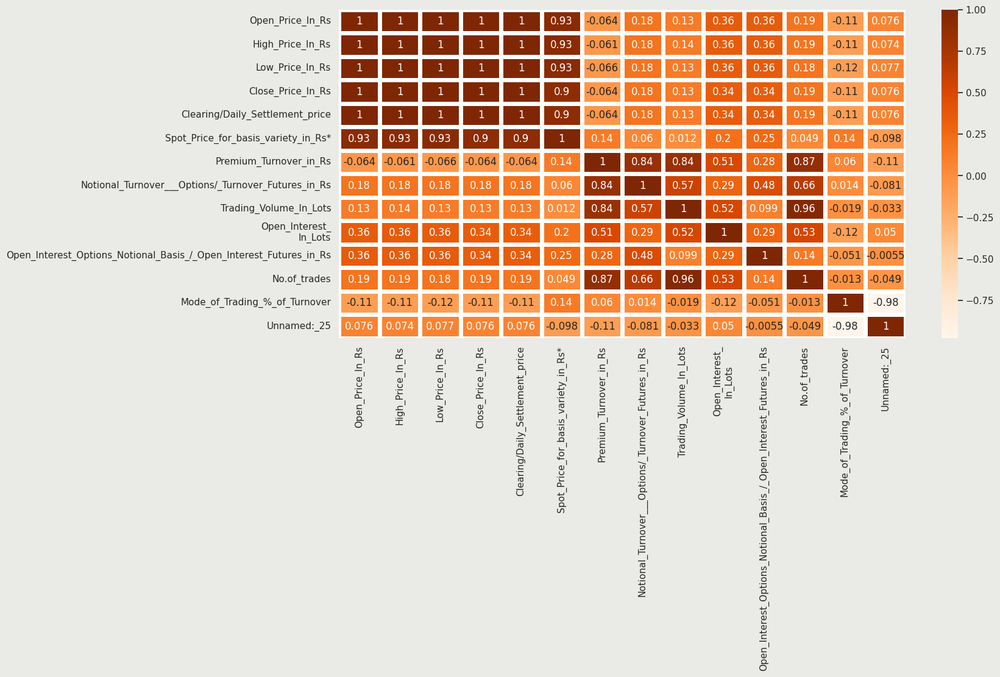

In [ ]:
 plt.figure(figsize = [15, 7], clear = True, facecolor = '#EAEAE6')
 sns.heatmap(df.corr(), annot = True, square = False, linewidths = 5,
             linecolor = "white", cmap = "Oranges");

In [ ]:
df['Trading_Volume_In_Lots'].isnull().sum()

100590

In [ ]:
df.dropna(subset=['Trading_Volume_In_Lots','Open_Price_In_Rs'], inplace=True)
df

,Year,Month,Date,Derivative_segment,Instrument_Type,Name_of_the_commodity,Symbol,Expiry_Date,Price_unit,Option_Type,...,Spot_Price_for_basis_variety_in_Rs*,Premium_Turnover_in_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,Open_Interest_Options_Notional_Basis_/_Open_Interest_Futures_in_Rs,No.of_trades,Mode_of_Trading_%_of_Turnover,Unnamed:_25
3,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-05-31 00:00:00,1 KGS,0,...,124.0,NaN,1.765282e+09,14063.0,17578.0,1 MT,2.228012e+09,8509.0,39.061255,60.938745
4,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM MINI,ALUMINI,2019-06-28 00:00:00,1 KGS,0,...,124.0,NaN,4.407795e+07,303.0,328.0,1 MT,4.798640e+07,292.0,49.679432,50.320568
5,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-05-31 00:00:00,1 KGS,0,...,NaN,NaN,1.664891e+09,2277.0,1342.0,5 MT,9.877120e+08,1728.0,31.599606,68.400394
6,2019,May,2019-05-01 00:00:00,Commodity Derivatives,FUTCOM,ALUMINIUM,ALUMINIUM,2019-06-28 00:00:00,1 KGS,0,...,NaN,NaN,3.580075e+07,49.0,136.0,5 MT,9.992600e+07,49.0,46.980161,53.019839
13,2019,May,2019-05-01 00:00:00,Commodity Derivatives,OPTFUT,COPPER,COPPER,2019-06-26 00:00:00,1 KGS,CE,...,NaN,23130.0,8.931300e+05,2.0,2.0,1 MT,8.931400e+05,2.0,50.000000,50.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.000000e+00,0.0,0.0,0,0.000000e+00,0.0,0.000000,0.000000
4596,Contracts with no volume and no Open Interest ...,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.000000e+00,0.0,0.0,0,0.000000e+00,0.0,0.000000,0.000000
4597,Spot price is not provided in case of Option C...,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.000000e+00,0.0,0.0,0,0.000000e+00,0.0,0.000000,0.000000
4598,In case of international referenceable commodi...,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.000000e+00,0.0,0.0,0,0.000000e+00,0.0,0.000000,0.000000


In [ ]:
df = df.drop(['Derivative_segment',
 'Instrument_Type','Symbol',
 'Expiry_Date',
 'Price_unit',
 'Option_Type','Premium_Turnover_in_Rs','Mode_of_Trading_%_of_Turnover','Open_Interest_Options_Notional_Basis_/_Open_Interest_Futures_in_Rs','Expiry_Date','Strike_Price_In_Rs','Clearing/Daily_Settlement_price',
 'Spot_Price_for_basis_variety_in_Rs*','Unnamed:_25'], axis =1)

df

,Year,Month,Date,Name_of_the_commodity,Open_Price_In_Rs,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,No.of_trades
3,2019,May,2019-05-01 00:00:00,ALUMINIUM MINI,125.00,126.90,124.10,126.75,1.765282e+09,14063.0,17578.0,1 MT,8509.0
4,2019,May,2019-05-01 00:00:00,ALUMINIUM MINI,145.00,146.75,144.40,146.30,4.407795e+07,303.0,328.0,1 MT,292.0
5,2019,May,2019-05-01 00:00:00,ALUMINIUM,146.15,147.75,144.80,147.20,1.664891e+09,2277.0,1342.0,5 MT,1728.0
6,2019,May,2019-05-01 00:00:00,ALUMINIUM,145.25,147.20,144.95,146.95,3.580075e+07,49.0,136.0,5 MT,49.0
13,2019,May,2019-05-01 00:00:00,COPPER,11.64,11.64,11.49,11.57,8.931300e+05,2.0,2.0,1 MT,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,Note:,0,0,0,0.00,0.00,0.00,0.00,0.000000e+00,0.0,0.0,0,0.0
4596,Contracts with no volume and no Open Interest ...,0,0,0,0.00,0.00,0.00,0.00,0.000000e+00,0.0,0.0,0,0.0
4597,Spot price is not provided in case of Option C...,0,0,0,0.00,0.00,0.00,0.00,0.000000e+00,0.0,0.0,0,0.0
4598,In case of international referenceable commodi...,0,0,0,0.00,0.00,0.00,0.00,0.000000e+00,0.0,0.0,0,0.0


In [ ]:
list(df.columns)

['Year',
 'Month',
 'Date',
 'Name_of_the_commodity',
 'Open_Price_In_Rs',
 'High_Price_In_Rs',
 'Low_Price_In_Rs',
 'Close_Price_In_Rs',
 'Notional_Turnover___Options/_Turnover_Futures_in_Rs',
 'Trading_Volume_In_Lots',
 'Open_Interest_\nIn_Lots',
 'Lot_size_and_unit',
 'No.of_trades']

In [ ]:
df1 = df[(df['Name_of_the_commodity'] == 'GOLD')]
df1

,Year,Month,Date,Name_of_the_commodity,Open_Price_In_Rs,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,No.of_trades
83,2019,May,2019-05-01 00:00:00,GOLD,507.0,507.0,507.0,507.0,3.190700e+06,1.0,8.0,1 KGS,1.0
84,2019,May,2019-05-01 00:00:00,GOLD,442.0,442.0,434.0,438.5,2.235685e+07,7.0,45.0,1 KGS,3.0
87,2019,May,2019-05-01 00:00:00,GOLD,257.0,275.5,257.0,266.0,1.282635e+07,4.0,36.0,1 KGS,4.0
88,2019,May,2019-05-01 00:00:00,GOLD,238.5,238.5,238.5,238.5,3.213850e+06,1.0,25.0,1 KGS,1.0
89,2019,May,2019-05-01 00:00:00,GOLD,187.0,221.0,177.0,202.0,2.768272e+08,86.0,210.0,1 KGS,55.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4494,2020,May,2020-05-29 00:00:00,GOLD,1178.5,1178.5,932.0,1035.0,1.379814e+08,29.0,24.0,1 KGS,19.0
4495,2020,May,2020-05-29 00:00:00,GOLD,1252.0,1252.0,1252.0,1252.0,4.815200e+06,1.0,1.0,1 KGS,1.0
4496,2020,May,2020-05-29 00:00:00,GOLD,1372.0,1393.5,1095.5,1132.5,1.350268e+08,28.0,31.0,1 KGS,23.0
4499,2020,May,2020-05-29 00:00:00,GOLD,46646.0,47166.0,46510.0,47104.0,3.252728e+10,6936.0,15279.0,1 KGS,5662.0


In [ ]:
df2 = df1.drop_duplicates(subset='Month')
df2


,Year,Month,Date,Name_of_the_commodity,Open_Price_In_Rs,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,No.of_trades
83,2019,May,2019-05-01 00:00:00,GOLD,507.0,507.0,507.0,507.0,3.190700e+06,1.0,8.0,1 KGS,1.0
33,2021,February,2021-02-01 00:00:00,GOLD,49370.0,49400.0,47200.0,48394.0,4.813319e+09,992.0,266.0,1 KGS,851.0
90,2022,June,2022-06-01 00:00:00,GOLD,50654.0,50903.0,50462.0,50788.0,2.277220e+08,45.0,314.0,1 KGS,33.0
75,2020,Jan,2020-01-01 00:00:00,GOLD,1465.0,1465.0,1465.0,1465.0,3.906500e+06,1.0,5.0,1 KGS,1.0
109,2018,December,2018-12-03 00:00:00,GOLD,30392.0,30853.0,30392.0,30748.0,1.305765e+09,427.0,185.0,1 KGS,347.0
87,2022,January,2022-01-03 00:00:00,GOLD,48050.0,48130.0,47691.0,47716.0,3.188059e+10,6654.0,8385.0,1 KGS,5520.0
84,2021,November,2021-11-01 00:00:00,GOLD,47615.0,47951.0,47590.0,47903.0,2.878717e+10,6027.0,8842.0,1 KGS,4890.0
98,2018,July,2018-07-02 00:00:00,GOLD,30399.0,30518.0,30270.0,30289.0,2.157606e+10,7096.0,6889.0,1 KGS,5281.0
65,2019,Dec,2019-12-02 00:00:00,GOLD,37717.0,38028.0,37100.0,37952.0,1.817130e+09,480.0,124.0,1 KGS,356.0
96,2022,August,2022-08-01 00:00:00,GOLD,51250.0,51489.0,51115.0,51263.0,1.195040e+09,233.0,84.0,1 KGS,218.0


<Axes: xlabel='Month'>

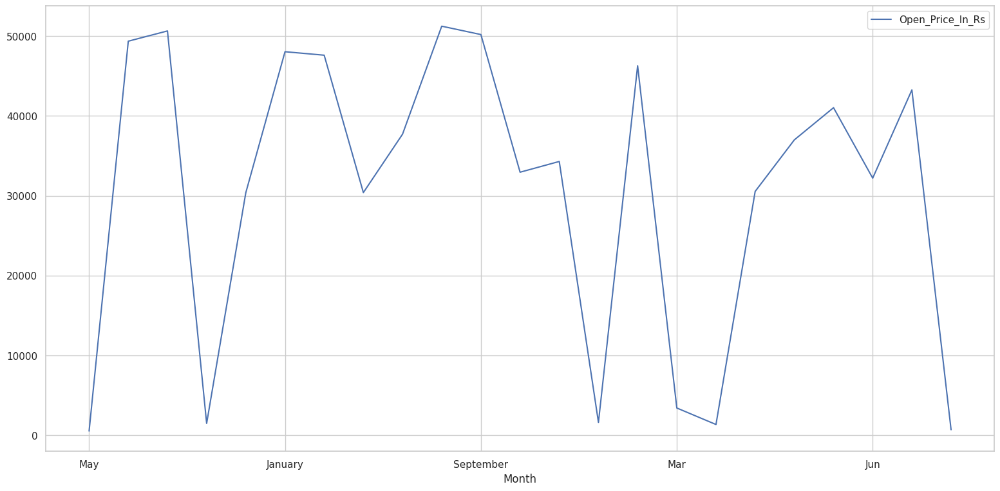

In [ ]:


#df1.plot(x="Month", y=["Open_Price_In_Rs", "Close_Price_In_Rs"], kind="bar", figsize=(25, 10))
df2.plot(x="Month", y=["Open_Price_In_Rs"], kind="line", figsize=(19, 9))
# sns.lineplot(ax = axes[1], x = df["date"], y = df["high"]);
# sns.lineplot(ax = axes[2], x = df["date"], y = df["low"]);
#sns.lineplot(ax = axes[0], x = df["Date"], y = df["Close_Price_In_Rs"]);
# sns.lineplot(ax = axes[4], x = df["date"], y = df["volume"]);

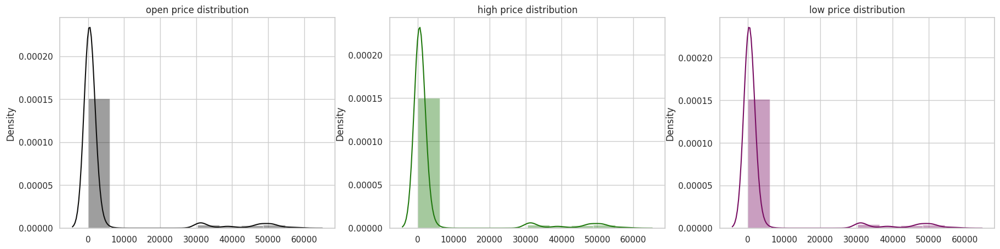

In [ ]:
fig, axes = plt.subplots(1, 3, figsize = (22, 5))

sns.distplot(ax = axes[0], x = df1["Open_Price_In_Rs"], hist = True, bins = 10, kde = True,
             vertical = False, color = "#0E0E0D").set(title = "open price distribution");

sns.distplot(ax = axes[1], x = df1["High_Price_In_Rs"], hist = True, bins = 10, kde = True,
             vertical = False, color = "#1F780D").set(title = "high price distribution");

sns.distplot(ax = axes[2], x = df1["Low_Price_In_Rs"], hist = True, bins = 10, kde = True,
             vertical = False, color = "#780D62").set(title = "low price distribution");

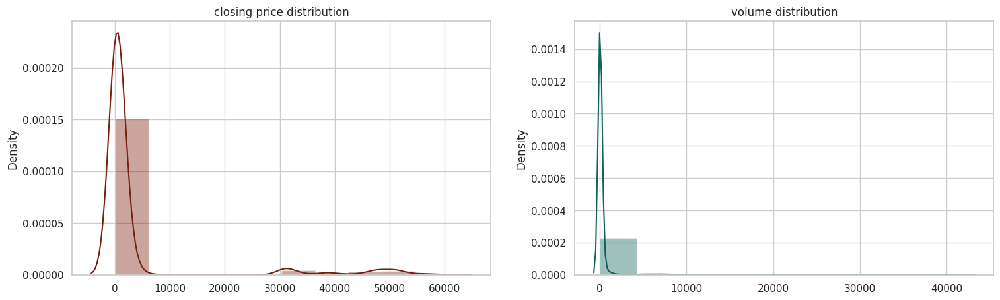

In [ ]:
fig, axes = plt.subplots(1, 2, figsize = (18, 5))

sns.distplot(ax = axes[0], x = df1["Close_Price_In_Rs"], hist = True, bins = 10, kde = True,
             vertical = False, color = "#781F0D").set(title = "closing price distribution");

sns.distplot(ax = axes[1], x = df1["Trading_Volume_In_Lots"], hist = True, bins = 10, kde = True,
             vertical = False, color = "#0D6559").set(title = "volume distribution");

In [ ]:
fig = px.histogram(df, x = "Close_Price_In_Rs", y = "Trading_Volume_In_Lots", marginal = "box", text_auto = True, template = "plotly_dark", hover_data  = df1.columns)
fig.show()

Evaluating the model

In [ ]:
import sklearn.metrics as metrics
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM

In [ ]:
X = df1[['High_Price_In_Rs','Low_Price_In_Rs','Close_Price_In_Rs']]
Y = df1['Open_Price_In_Rs']
print(X)
print(Y)

      High_Price_In_Rs  Low_Price_In_Rs  Close_Price_In_Rs
83               507.0            507.0              507.0
84               442.0            434.0              438.5
87               275.5            257.0              266.0
88               238.5            238.5              238.5
89               221.0            177.0              202.0
...                ...              ...                ...
4494            1178.5            932.0             1035.0
4495            1252.0           1252.0             1252.0
4496            1393.5           1095.5             1132.5
4499           47166.0          46510.0            47104.0
4500           47256.0          46636.0            47238.0

[39912 rows x 3 columns]
83        507.0
84        442.0
87        257.0
88        238.5
89        187.0
         ...   
4494     1178.5
4495     1252.0
4496     1372.0
4499    46646.0
4500    46726.0
Name: Open_Price_In_Rs, Length: 39912, dtype: float64


In [ ]:
df1

,Year,Month,Date,Name_of_the_commodity,Open_Price_In_Rs,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs,Notional_Turnover___Options/_Turnover_Futures_in_Rs,Trading_Volume_In_Lots,Open_Interest_\nIn_Lots,Lot_size_and_unit,No.of_trades
83,2019,May,2019-05-01 00:00:00,GOLD,507.0,507.0,507.0,507.0,3.190700e+06,1.0,8.0,1 KGS,1.0
84,2019,May,2019-05-01 00:00:00,GOLD,442.0,442.0,434.0,438.5,2.235685e+07,7.0,45.0,1 KGS,3.0
87,2019,May,2019-05-01 00:00:00,GOLD,257.0,275.5,257.0,266.0,1.282635e+07,4.0,36.0,1 KGS,4.0
88,2019,May,2019-05-01 00:00:00,GOLD,238.5,238.5,238.5,238.5,3.213850e+06,1.0,25.0,1 KGS,1.0
89,2019,May,2019-05-01 00:00:00,GOLD,187.0,221.0,177.0,202.0,2.768272e+08,86.0,210.0,1 KGS,55.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4494,2020,May,2020-05-29 00:00:00,GOLD,1178.5,1178.5,932.0,1035.0,1.379814e+08,29.0,24.0,1 KGS,19.0
4495,2020,May,2020-05-29 00:00:00,GOLD,1252.0,1252.0,1252.0,1252.0,4.815200e+06,1.0,1.0,1 KGS,1.0
4496,2020,May,2020-05-29 00:00:00,GOLD,1372.0,1393.5,1095.5,1132.5,1.350268e+08,28.0,31.0,1 KGS,23.0
4499,2020,May,2020-05-29 00:00:00,GOLD,46646.0,47166.0,46510.0,47104.0,3.252728e+10,6936.0,15279.0,1 KGS,5662.0


In [ ]:
df1.shape

(39912, 13)

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state=2)
X_train
Y_train


487       117.0
119       100.5
3427    31450.0
179        50.5
2353     3000.0
         ...   
1427     1130.0
736        16.5
7092       85.5
1425       87.5
626        61.0
Name: Open_Price_In_Rs, Length: 31929, dtype: float64

In [ ]:
X_test.shape

(7983, 3)

# Random regression model

In [ ]:
model_trainer = RandomForestRegressor(n_estimators=150)
model_trainer.fit(X_train,Y_train)

RandomForestRegressor(n_estimators=150)

In [ ]:
test_data_prediction = model_trainer.predict(X_test)

In [ ]:
Y_test = list(Y_test)


In [ ]:
print(Y_test)

[8.0, 60.0, 1000.0, 1000.0, 47374.0, 374.5, 333.0, 170.5, 48.0, 44575.0, 101.5, 42.0, 29.5, 50585.0, 51430.0, 247.0, 309.0, 1366.0, 54750.0, 47850.0, 99.0, 226.5, 40.0, 808.5, 3574.0, 1600.0, 95.0, 1205.5, 538.5, 182.5, 616.0, 1281.5, 1280.0, 937.0, 886.5, 33.5, 171.0, 3.0, 331.0, 309.0, 38.5, 576.0, 175.5, 505.0, 4.5, 246.5, 2567.0, 608.5, 20.0, 1.5, 199.5, 33.0, 1018.0, 654.0, 136.5, 1572.0, 6133.5, 245.5, 38.5, 55247.0, 1259.5, 79.5, 96.0, 300.0, 57.5, 47.0, 737.0, 140.5, 126.5, 342.0, 595.0, 0.5, 735.5, 210.0, 2.5, 3441.0, 231.0, 219.0, 172.5, 46460.0, 9.5, 1420.0, 140.0, 1683.0, 89.0, 545.5, 437.0, 60.0, 279.0, 9.5, 65.0, 204.0, 49100.0, 1400.0, 600.0, 16.0, 837.5, 96.0, 1800.0, 125.0, 1216.0, 50525.0, 1750.0, 45.0, 90.0, 37.5, 43799.0, 56750.0, 66.0, 24.0, 476.0, 51790.0, 1850.0, 14.0, 1250.0, 836.5, 411.0, 950.0, 71.5, 31625.0, 46470.0, 13.0, 280.0, 1115.5, 80.0, 470.0, 4.5, 2180.0, 1035.0, 760.0, 1175.0, 355.0, 219.0, 337.5, 53126.0, 610.5, 400.0, 3.5, 22.0, 1650.0, 798.0, 506.

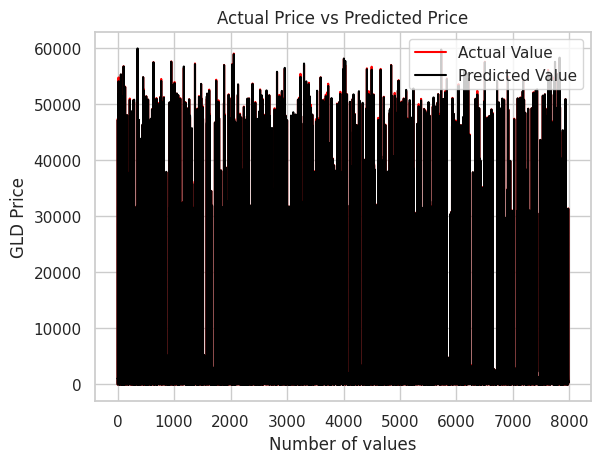

In [ ]:
plt.plot(Y_test, color='red', label = 'Actual Value')
plt.plot(test_data_prediction, color='black', label='Predicted Value')
plt.title('Actual Price vs Predicted Price')
plt.xlabel('Number of values')
plt.ylabel('GLD Price')
plt.legend()
plt.show()

In [ ]:
Y_test = np.array(Y_test)
test_data_prediction = np.array(test_data_prediction)

Y_test = np.reshape(Y_test, (-1, 1))
test_data_prediction = np.reshape(test_data_prediction, (-1, 1))
model_trainer.score(X_train, Y_train)

0.9999930588946458

In [ ]:
error_score = metrics.r2_score(Y_test, test_data_prediction)
print("R squared error : ", error_score)

rmse = np.sqrt(np.mean(((test_data_prediction - Y_test) ** 2)))
print("RMSE score of the model:", rmse)

R squared error :  0.9999485209974938
RMSE score of the model: 85.76969894754801


# **TO dump the data into a pickle file**


In [ ]:
import os
import sys
import pickle

projectabspathname = os.path.abspath('projectname.pickle')
print(projectabspathname)
projectname = 'projectname.ipynb'
projectpickle = open(str(projectabspathname),'wb')
pickle.dump(model_trainer, projectpickle)
projectpickle.close()

/content/projectname.pickle


In [ ]:
pickle.dump(model_trainer,open('/content/sample_data/gold.pkl','wb'))

In [ ]:
x=pickle.load(open('/content/sample_data/gold.pkl','rb'))

In [ ]:
#input_data=(25183.0,24973.0,24994.0,5.457468e+09,2171.0)
#input_data_as_numpy_array=np.asarray(input_data)
#input_data_reshaped=input_data_as_numpy_array.reshape(1,-1)
#prediction=Y_test.predict(input_data_reshaped)[0]

In [58]:
X_test

,High_Price_In_Rs,Low_Price_In_Rs,Close_Price_In_Rs
3529,8.0,1.5,3.0
731,60.0,56.0,58.0
3316,1117.0,802.5,844.0
255,1398.0,1000.0,1231.0
2880,47437.0,47026.0,47132.0
...,...,...,...
2781,31395.0,31185.0,31200.0
6483,1399.0,1399.0,1399.0
6539,444.0,403.0,426.5
331,365.0,273.5,302.0


In [ ]:
model_trainer.predict([[60771.0,	59700.0,	58764.0]])

array([60320.95333333])

Executing different type of models to compare take the best fit model


# **Linear Regression Model**

In [59]:
# Model training: Linear Regression
from sklearn.linear_model import LinearRegression
lr_model = LinearRegression() 
lr_model.fit(X_train,Y_train)
lr_pred = lr_model.predict(X_test)
error_score = metrics.r2_score(Y_test,lr_pred)
print("R squared score for Linear regression is : ", error_score)

R squared score for Linear regression is :  0.9999575101762128


# **Decision Tree**

In [60]:
# Model training: Decision Tree
from sklearn.tree import DecisionTreeRegressor
dt_model=DecisionTreeRegressor()
dt_model.fit(X_train,Y_train)
dt_pred = dt_model.predict(X_test)
error_score = metrics.r2_score(Y_test,dt_pred)
print("R squared score for Decision tree is : ", error_score)

R squared score for Decision tree is :  0.9999065073152988


# **KNN model**

In [61]:
# Model training: KNN
from sklearn.neighbors import KNeighborsRegressor
knn_model = KNeighborsRegressor(n_neighbors=5)
knn_model.fit(X_train,Y_train)
knn_pred = knn_model.predict(X_test)
error_score = metrics.r2_score(Y_test,knn_pred)
print("R squared score for KNN is : ", error_score)

R squared score for KNN is :  0.9999430178182134


# Graphs of the models to analyse the difference between predicted value and actual value of linear regression,KNN,decision tree

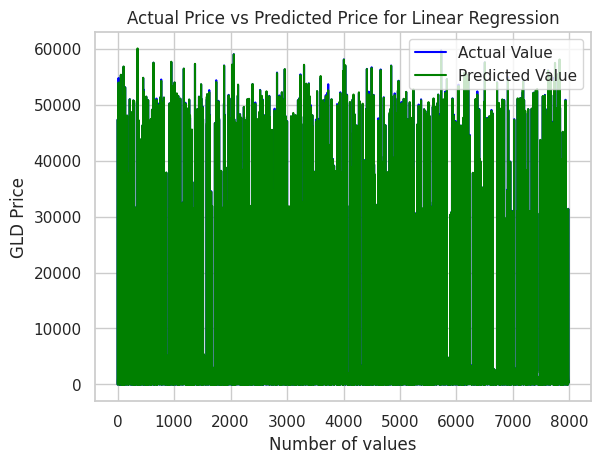

In [62]:
# Actual and predicted values plot for Linear Regression
Y_test = list(Y_test)
plt.plot(Y_test, color='blue', label = 'Actual Value')
plt.plot(lr_pred, color='green', label='Predicted Value')
plt.title('Actual Price vs Predicted Price for Linear Regression')
plt.xlabel('Number of values')
plt.ylabel('GLD Price')
plt.legend()
plt.show()

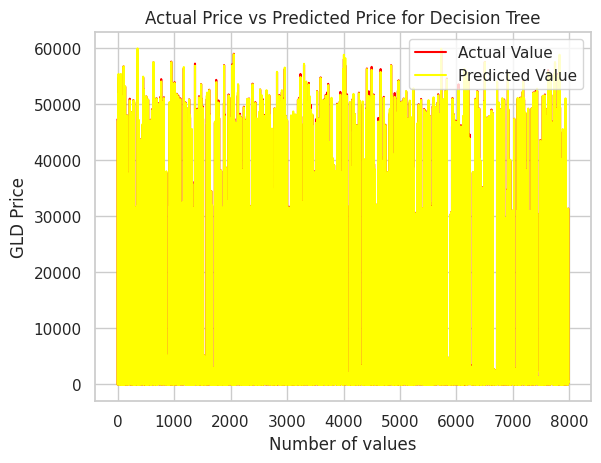

In [63]:
# Actual and predicted values plot for Decision Tree
Y_test = list(Y_test)
plt.plot(Y_test, color='red', label = 'Actual Value')
plt.plot(dt_pred, color='yellow', label='Predicted Value')
plt.title('Actual Price vs Predicted Price for Decision Tree')
plt.xlabel('Number of values')
plt.ylabel('GLD Price')
plt.legend()
plt.show()

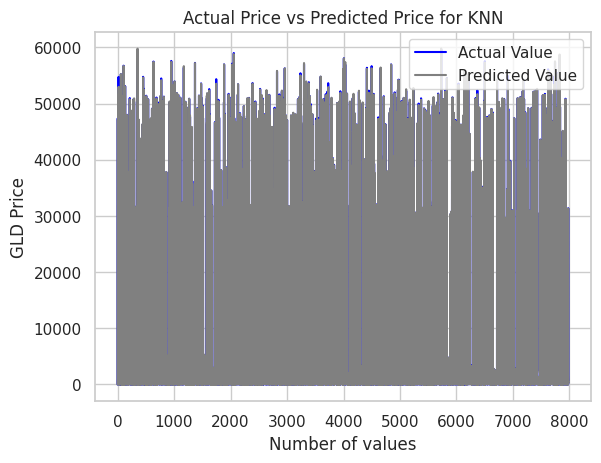

In [64]:
# Actual and predicted values plot for KNN
Y_test = list(Y_test)
plt.plot(Y_test, color='blue', label = 'Actual Value')
plt.plot(knn_pred, color='grey', label='Predicted Value')
plt.title('Actual Price vs Predicted Price for KNN')
plt.xlabel('Number of values')
plt.ylabel('GLD Price')
plt.legend()
plt.show()

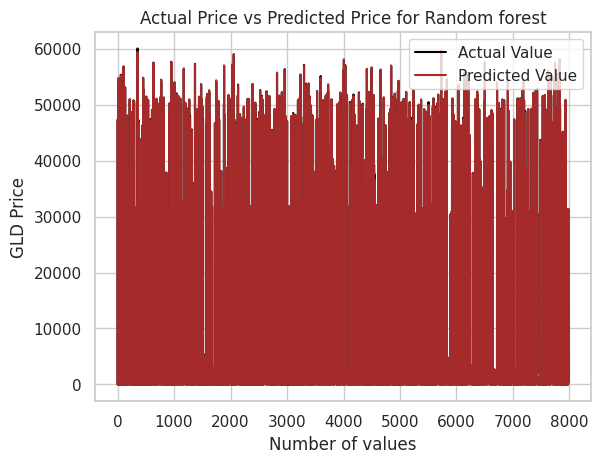

In [80]:
# Actual and predicted values plot for Random forest
Y_test = list(Y_test)
plt.plot(lr_pred, color='black', label = 'Actual Value')
plt.plot(Y_test, color='brown', label='Predicted Value')
plt.title('Actual Price vs Predicted Price for Random forest')
plt.xlabel('Number of values')
plt.ylabel('GLD Price')
plt.legend()
plt.show()